# Introduction to Data Science and Machine Learning

<p align="center">
    <img width="699" alt="image" src="https://user-images.githubusercontent.com/49638680/159042792-8510fbd1-c4ac-4a48-8320-bc6c1a49cdae.png">
</p>

---

## Feature Engineering Homework
 
Perform feature engineering on a dataset to transform data into a suitable form for a machine learning algorithm.

__Bonus__: Make nice (and _useful_) data visualisation plots.

### The dataset

The [Concrete](https://www.kaggle.com/sinamhd9/concrete-comprehensive-strength) dataset contains a variety of concrete formulations and the resulting product's compressive strength, which is a measure of how much load that kind of concrete can bear. For your information, the task for this dataset is to predict a concrete's compressive strength given its formulation.

In [1]:
# Import libraries
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns

%matplotlib inline
%config InlineBackend.figure_format = "retina"

# set font and plot size to be larger
plt.rcParams.update({'font.size': 20, 'figure.figsize': (20, 13)})

### Import data

In [2]:
url_data = "https://raw.githubusercontent.com/stedy/Machine-Learning-with-R-datasets/master/concrete.csv"

df = pd.read_csv(url_data)
df.head()

,cement,slag,ash,water,superplastic,coarseagg,fineagg,age,strength
0,540.0,0.0,0.0,162.0,2.5,1040.0,676.0,28,79.99
1,540.0,0.0,0.0,162.0,2.5,1055.0,676.0,28,61.89
2,332.5,142.5,0.0,228.0,0.0,932.0,594.0,270,40.27
3,332.5,142.5,0.0,228.0,0.0,932.0,594.0,365,41.05
4,198.6,132.4,0.0,192.0,0.0,978.4,825.5,360,44.30


<details>
    <summary><b>Hints and suggestions</b></summary> 
    You can see here the various ingredients going into each variety of concrete. 
    Here some suggestions that you might find useful.
    <ul>
        <li> Adding some additional synthetic features derived from the original ones in the dataset can help a model to learn important relationships among them.</li>
        <li> Try to establish a <b>baseline</b> (_e.g._ a simple stupid model) by training the model on the untouched dataset. This will help you determine whether our new features are actually useful.</li>
    </ul>
    Establishing baselines like this is good practice at the start of the feature engineering process. A baseline score can help you decide whether your new features are worth keeping, or whether you should discard them and possibly try something else.        
</details>


---

## Your work

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1030 entries, 0 to 1029
Data columns (total 9 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   cement        1030 non-null   float64
 1   slag          1030 non-null   float64
 2   ash           1030 non-null   float64
 3   water         1030 non-null   float64
 4   superplastic  1030 non-null   float64
 5   coarseagg     1030 non-null   float64
 6   fineagg       1030 non-null   float64
 7   age           1030 non-null   int64  
 8   strength      1030 non-null   float64
dtypes: float64(8), int64(1)
memory usage: 72.5 KB


In [4]:
from pandas.plotting import scatter_matrix
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler, StandardScaler
import pandas_profiling as pp
import warnings
warnings.filterwarnings('ignore')

In [5]:
#Creating train and test set
X_train, X_test, y_train, y_test = train_test_split(df.values[:,:-1], df.values[:,-1], test_size = 0.15)
train_set = pd.DataFrame(X_train, columns = df.columns[:-1])
train_set['strength'] = y_train
test_set = pd.DataFrame(X_test, columns = df.columns[:-1])
test_set['strength'] = y_test
train_set

,cement,slag,ash,water,superplastic,coarseagg,fineagg,age,strength
0,425.0,106.3,0.0,153.5,16.5,852.1,887.1,3.0,33.40
1,234.0,156.0,0.0,189.0,5.9,981.0,760.0,28.0,39.30
2,425.0,106.3,0.0,153.5,16.5,852.1,887.1,91.0,65.20
3,500.0,0.0,0.0,200.0,0.0,1125.0,613.0,28.0,44.09
4,238.1,0.0,94.1,186.7,7.0,949.9,847.0,28.0,30.23
...,...,...,...,...,...,...,...,...,...
870,375.0,0.0,0.0,186.0,0.0,1038.0,758.0,7.0,26.06
871,190.3,0.0,125.2,161.9,9.9,1088.1,802.6,14.0,22.72
872,314.0,145.0,113.0,179.0,8.0,869.0,690.0,28.0,46.23
873,362.6,189.0,0.0,164.9,11.6,944.7,755.8,28.0,71.30


Observing features distributions

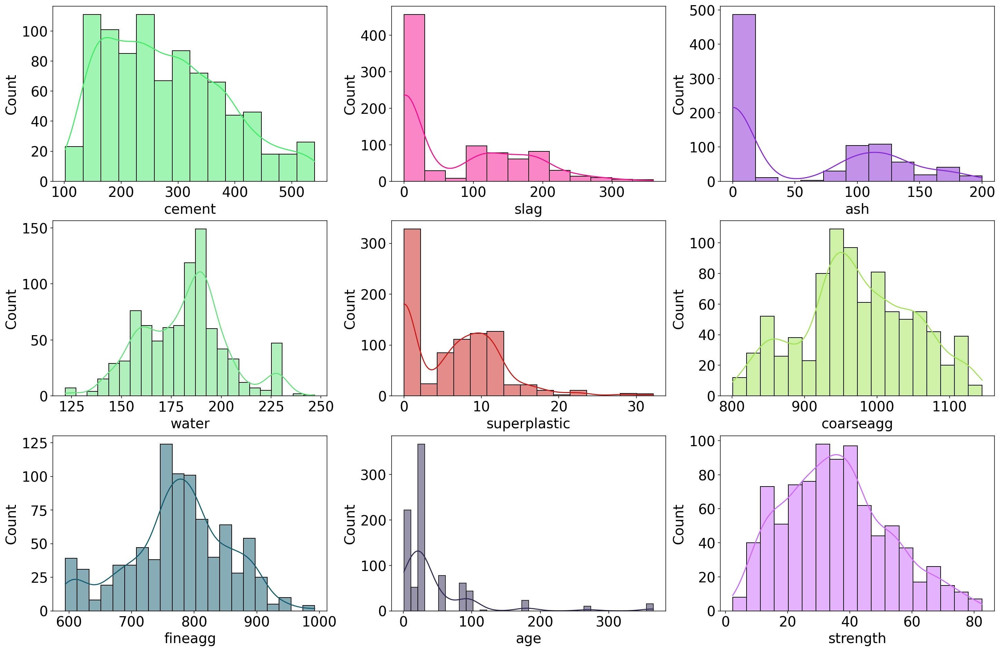

In [6]:
fig,axes = plt.subplots(3, 3, constrained_layout = True)
for i,ax in enumerate(axes.ravel()):
    rgb = np.random.rand(3,)
    graph = sns.histplot( x = train_set.iloc[:,i], kde = True, color = rgb, ax = ax)

Observing correlations beetwen features and target variable and correlation between features

<AxesSubplot:>

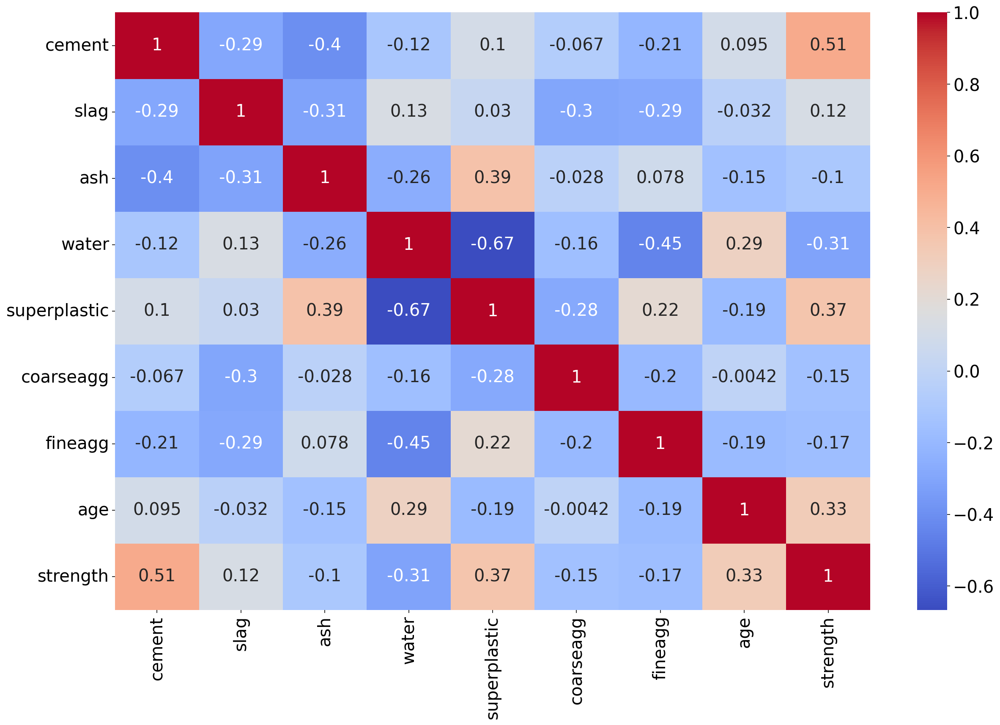

In [7]:
sns.heatmap(train_set.corr(), annot = True, cmap = 'coolwarm')

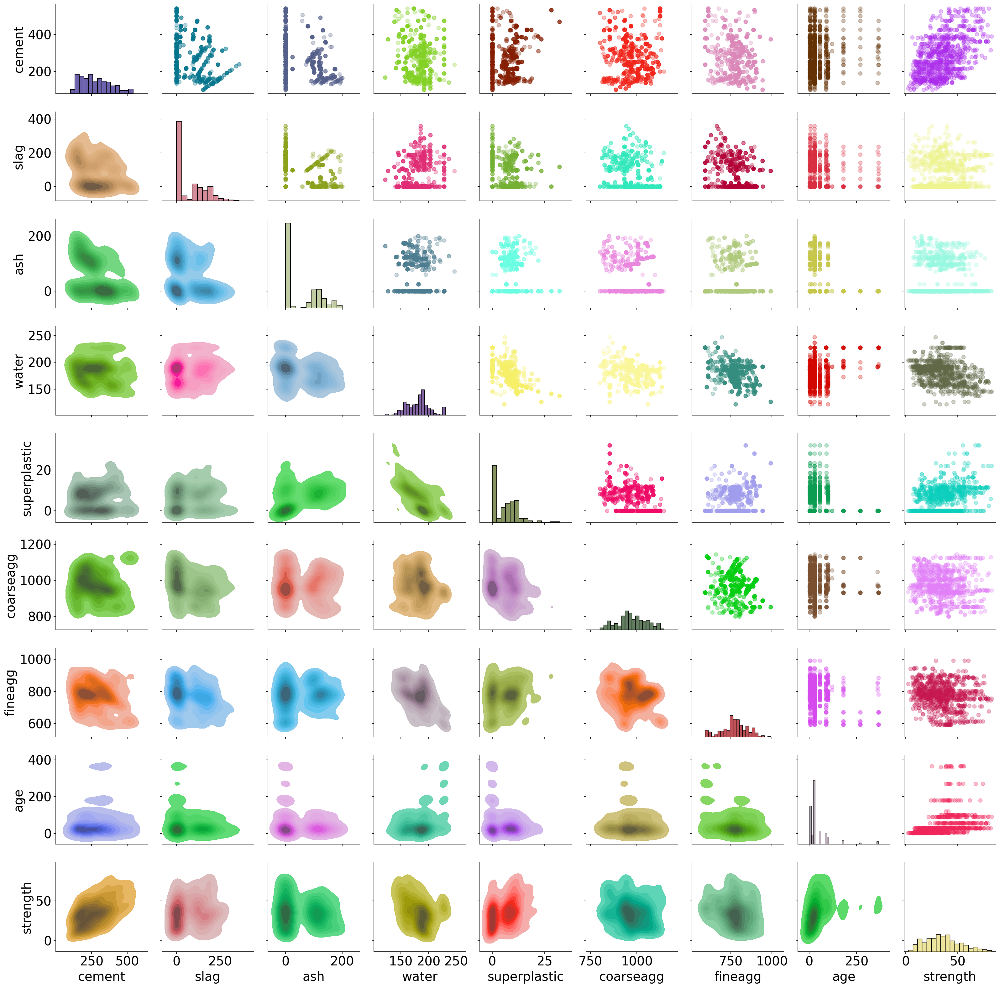

In [8]:
def my_scatter(x, y, **kwargs):
    kwargs['color'] = np.append(np.random.rand(3,), 0.3)
    plt.scatter(x, y, **kwargs)

def my_kde(x, y, **kwargs):
    kwargs['color'] = np.random.rand(3,)
    sns.kdeplot(x, y, fill = True,**kwargs)

def my_hist(x, **kwargs):
    kwargs['color'] = np.random.rand(3,)
    sns.histplot(x, **kwargs)

graph = sns.PairGrid(train_set)
graph.map_diag(my_hist)
graph.map_upper(my_scatter)
graph.map_lower(my_kde)

Let's see in more detail correlations with target variable 'strength'

In [9]:
corr = train_set.corr().sort_values(by = 'strength', ascending = False).strength
corr

strength        1.000000
cement          0.509415
superplastic    0.370794
age             0.327172
slag            0.123029
ash            -0.104317
coarseagg      -0.151585
fineagg        -0.169285
water          -0.310189
Name: strength, dtype: float64

Regression plot in order of correlation, mid graphs are the less correlated, first and last are the most correlated

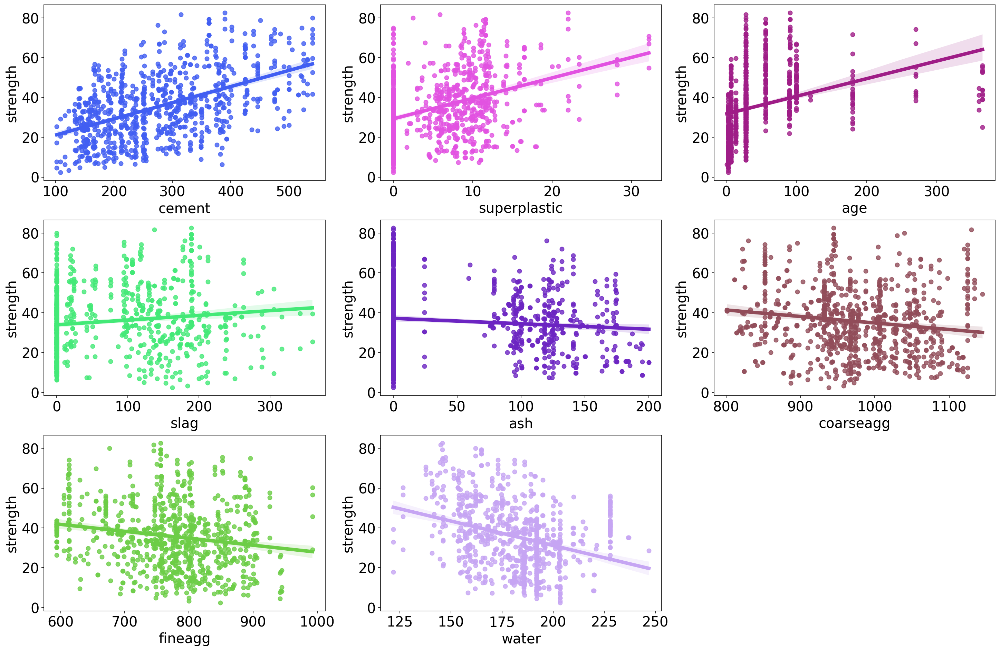

In [10]:
fig, axes = plt.subplots(3,3, constrained_layout = True)
for i, ax in enumerate(axes.ravel()):
    if i == 8:
        fig.delaxes(ax)
        continue
    sns.regplot(x = train_set[corr.index[i+1]], y = train_set[corr.index[0]], color = np.random.rand(3,), line_kws={'linewidth':5}, ax = ax)

Let's see the density of data

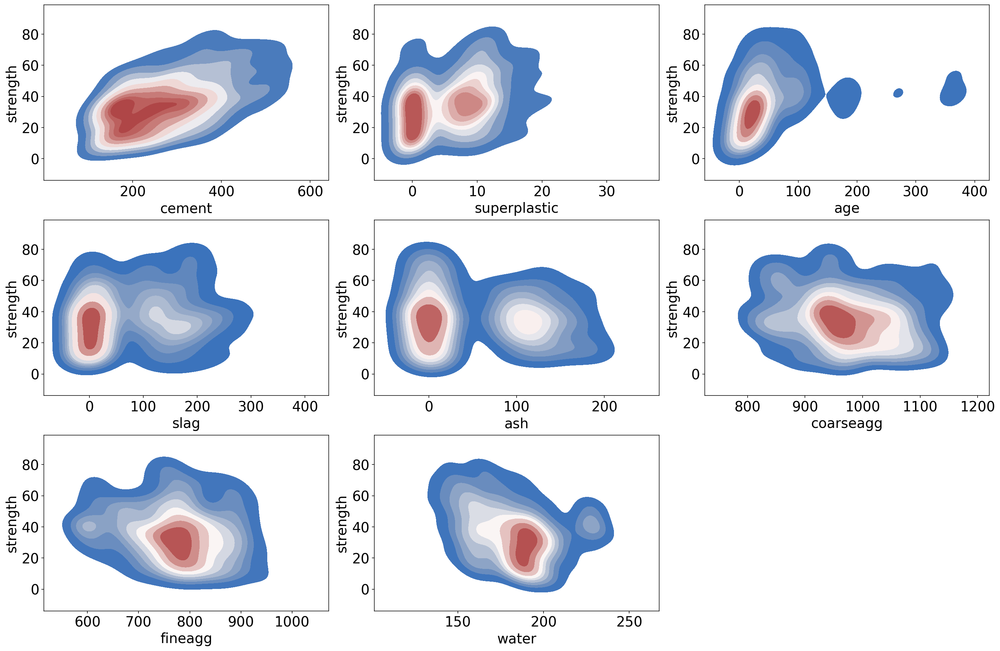

In [11]:
cmap = ['rocket', 'mako', 'flare', 'crest', 'magma', 'viridis', 'vlag', 'icefire', 'Spectral', 'coolwarm']
#Uso un solo colore per comprensibilità del grafico 
cmap_index = np.random.randint(0,10)

fig, axes = plt.subplots(3,3, constrained_layout = True)
for i, ax in enumerate(axes.ravel()):
    if i == 8:
        fig.delaxes(ax)
        continue
    sns.kdeplot(x = train_set[corr.index[i+1]], y = train_set[corr.index[0]], fill = True, alpha = 1, cmap = cmap[cmap_index], ax = ax)

In [12]:
#just a recap
pp.ProfileReport(train_set)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Let's separate X from y

Baseline model

In [13]:
#Baseline
from sklearn.neighbors import KNeighborsRegressor
from sklearn.model_selection import GridSearchCV

X_train = train_set.iloc[:,:-1]
y_train = train_set.iloc[:,-1]
X_test = test_set.iloc[:,:-1]
y_test = test_set.iloc[:,-1]

knn = KNeighborsRegressor()
knn.fit(X_train, y_train)
print('KNN baseline =', knn.score(X_test, y_test))

KNN baseline = 0.6208918263119424


Scaling and hyperparameters setting

KNN score = 0.7658250016935204
KNN best parameters = {'metric': 'euclidean', 'n_neighbors': 6, 'weights': 'distance'}


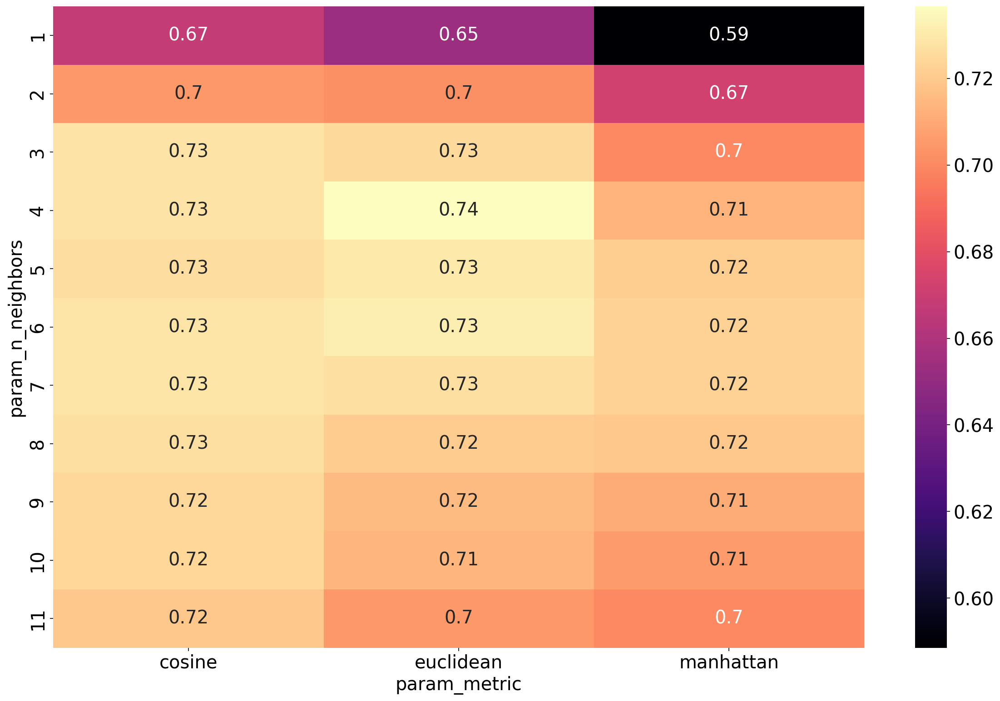

In [14]:

scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

#Tuning hyperparameters KNN
parameters = {'n_neighbors':[i for i in range(1,12)],
              'weights':['uniform', 'distance'],
              'metric':['euclidean','manhattan', 'cosine']}
knn = KNeighborsRegressor()
grid = GridSearchCV(knn, parameters) 
grid.fit(X_train_scaled, y_train)
print('KNN score =', grid.best_estimator_.score(X_test_scaled, y_test))
print('KNN best parameters =', grid.best_params_)

hmknn = pd.pivot_table(pd.DataFrame(grid.cv_results_),
									values='mean_test_score',
									index='param_n_neighbors',
									columns='param_metric')

sns.heatmap(hmknn, cmap = 'magma', annot = True)

#Metric used to evaluate the ditribution of the model 
err_knn = (grid.predict(X_test_scaled) - y_test)/y_test

Drop columns with less correlation |corr(strength)| < 0.2 

In [15]:
X_train = train_set.drop(['slag', 'ash', 'coarseagg', 'fineagg'], axis = 1).iloc[:,:-1]
y_train = train_set.iloc[:,-1]
X_test = test_set.drop(['slag', 'ash', 'coarseagg', 'fineagg'], axis = 1).iloc[:,:-1]
y_test = test_set.iloc[:,-1]

KNN score = 0.7558138558542264
KNN best parameters = {'metric': 'manhattan', 'n_neighbors': 10, 'weights': 'distance'}


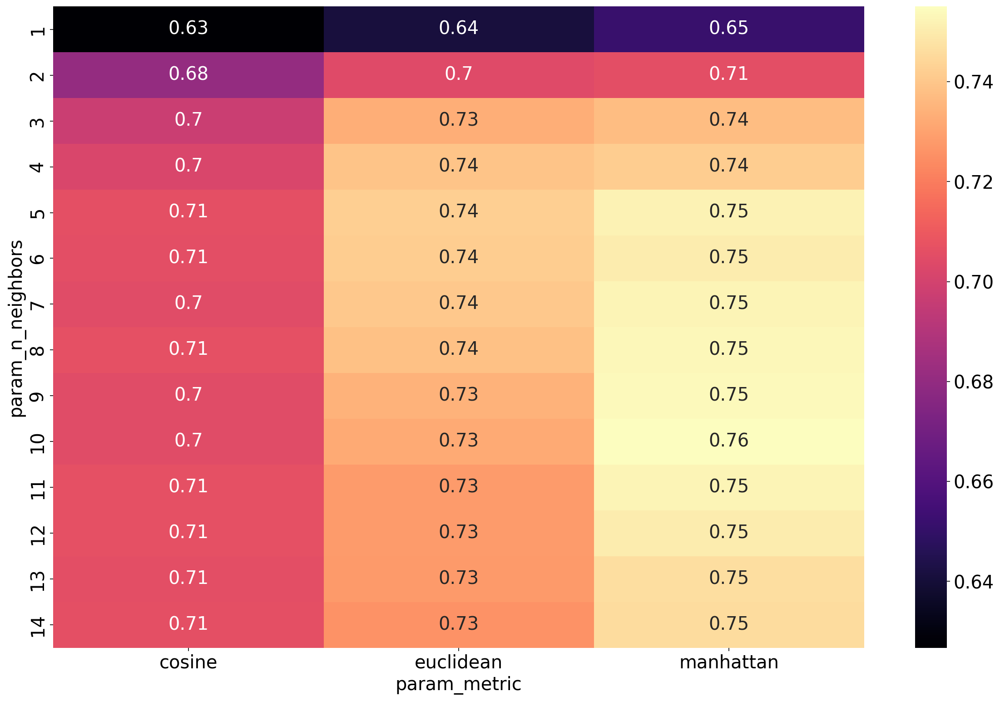

In [16]:
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

parameters = {'n_neighbors':[i for i in range(1,15)],
              'weights':['uniform', 'distance'],
              'metric':['euclidean','manhattan', 'cosine']}
knn = KNeighborsRegressor()
grid = GridSearchCV(knn, parameters) 
grid.fit(X_train_scaled, y_train)
print('KNN score =', grid.best_estimator_.score(X_test_scaled, y_test))
print('KNN best parameters =', grid.best_params_)

hmknn = pd.pivot_table(pd.DataFrame(grid.cv_results_),
									values='mean_test_score',
									index='param_n_neighbors',
									columns='param_metric')

sns.heatmap(hmknn, cmap = 'magma', annot = True)
err_knn2 = (grid.predict(X_test_scaled) - y_test)/y_test

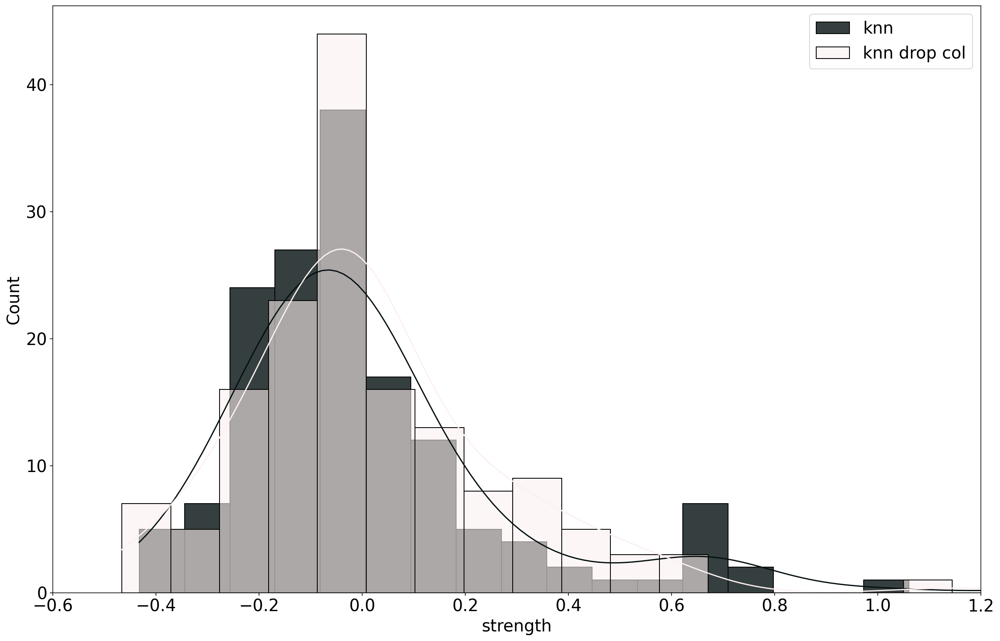

In [17]:
c = np.random.uniform(0,0.5,3)
sns.histplot(err_knn, alpha = 0.8, label = 'knn', kde = True, color = c )
sns.histplot(err_knn2, alpha = 0.6, label = 'knn drop col', kde = True, color = 1-c)
plt.xlim(-0.6, 1.2)
plt.legend()

Models are similar even with data dropped

Try to drop duplicates

In [18]:
X_train = train_set.drop_duplicates().iloc[:,:-1]
y_train = train_set.drop_duplicates().iloc[:,-1]
X_test = test_set.iloc[:,:-1]
y_test = test_set.iloc[:,-1]

KNN score = 0.7431041420885431
KNN best parameters = {'metric': 'euclidean', 'n_neighbors': 4, 'weights': 'distance'}


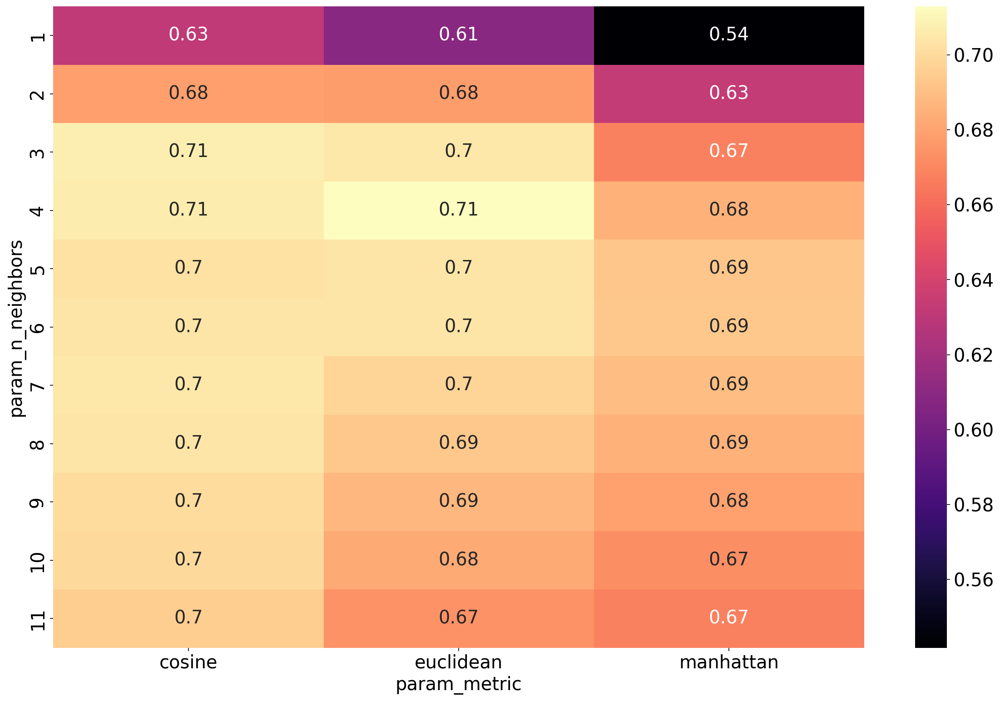

In [19]:
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

#Tuning hyperparameters KNN
parameters = {'n_neighbors':[i for i in range(1,12)],
              'weights':['uniform', 'distance'],
              'metric':['euclidean','manhattan', 'cosine']}
knn = KNeighborsRegressor()
grid = GridSearchCV(knn, parameters) 
grid.fit(X_train_scaled, y_train)
print('KNN score =', grid.best_estimator_.score(X_test_scaled, y_test))
print('KNN best parameters =', grid.best_params_)

hmknn = pd.pivot_table(pd.DataFrame(grid.cv_results_),
									values='mean_test_score',
									index='param_n_neighbors',
									columns='param_metric')

sns.heatmap(hmknn, cmap = 'magma', annot = True)
err_knn3 = (grid.predict(X_test_scaled) - y_test)/y_test

Drop duplicates and columns with low correlation

In [20]:
train_set_drop = train_set.drop(['slag', 'ash', 'coarseagg', 'fineagg'], axis = 1)
test_set_drop = test_set.drop(['slag', 'ash', 'coarseagg', 'fineagg'], axis = 1)

X_train = train_set_drop.drop_duplicates().iloc[:,:-1]
y_train = train_set_drop.drop_duplicates().iloc[:,-1]
X_test = test_set_drop.iloc[:,:-1]
y_test = test_set_drop.iloc[:,-1]

KNN score = 0.7540363760297426
KNN best parameters = {'metric': 'manhattan', 'n_neighbors': 10, 'weights': 'distance'}


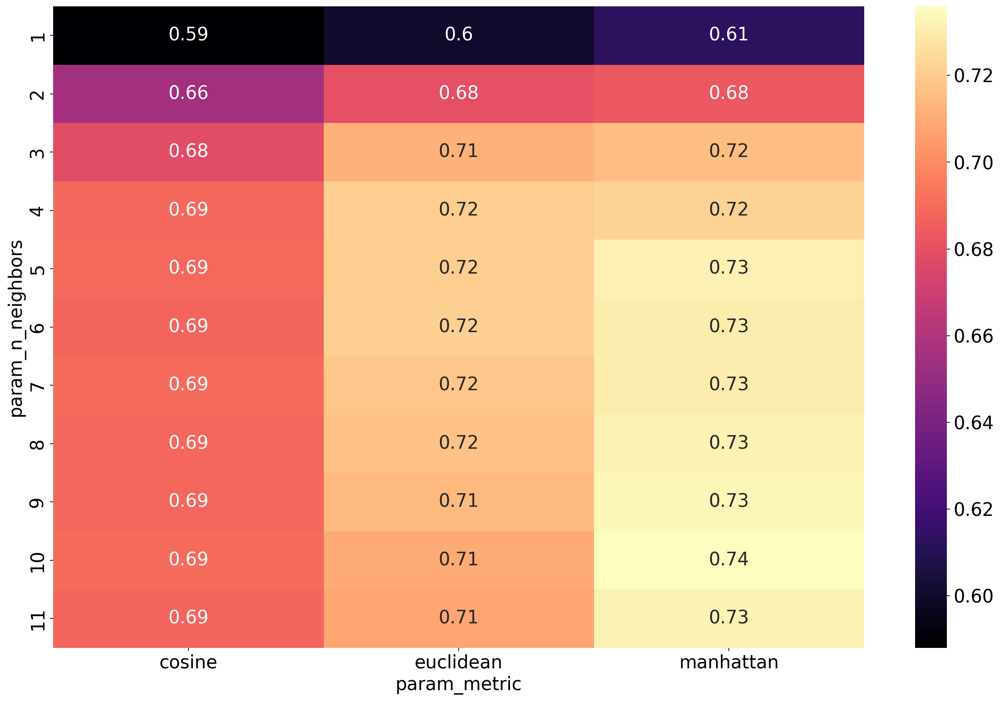

In [21]:
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

#Tuning hyperparameters KNN
parameters = {'n_neighbors':[i for i in range(1,12)],
              'weights':['uniform', 'distance'],
              'metric':['euclidean','manhattan', 'cosine']}
knn = KNeighborsRegressor()
grid = GridSearchCV(knn, parameters) 
grid.fit(X_train_scaled, y_train)
print('KNN score =', grid.best_estimator_.score(X_test_scaled, y_test))
print('KNN best parameters =', grid.best_params_)

hmknn = pd.pivot_table(pd.DataFrame(grid.cv_results_),
									values='mean_test_score',
									index='param_n_neighbors',
									columns='param_metric')

sns.heatmap(hmknn, cmap = 'magma', annot = True)
err_knn4 = (grid.predict(X_test_scaled) - y_test)/y_test

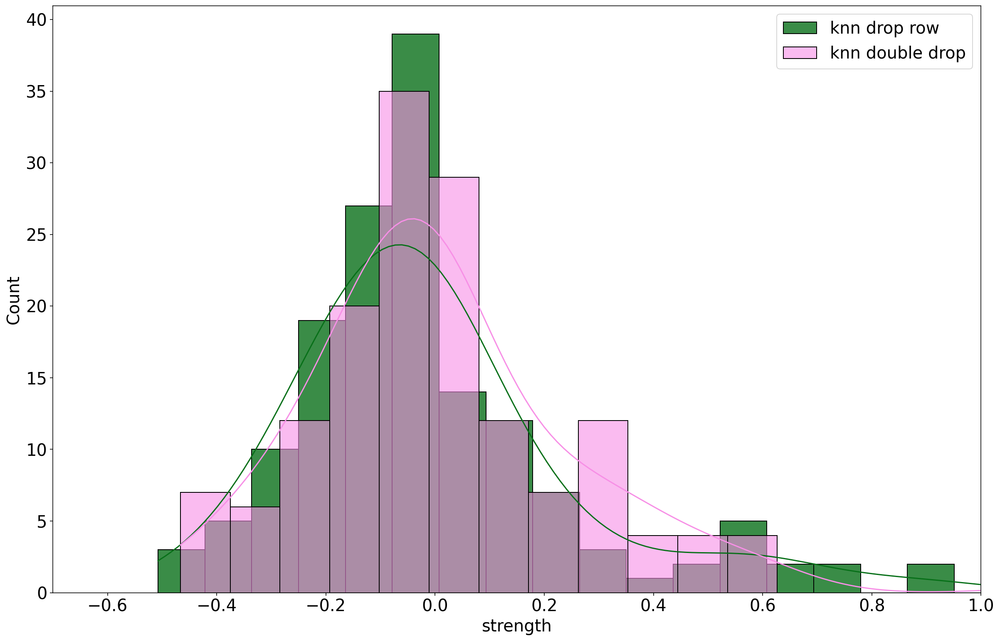

In [22]:
c = np.random.uniform(0,0.5,3)
sns.histplot(err_knn3, alpha = 0.8, label = 'knn drop row', kde = True, color = c )
sns.histplot(err_knn4, alpha = 0.6, label = 'knn double drop', kde = True, color = 1-c)
plt.xlim(-0.7, 1)
plt.legend()

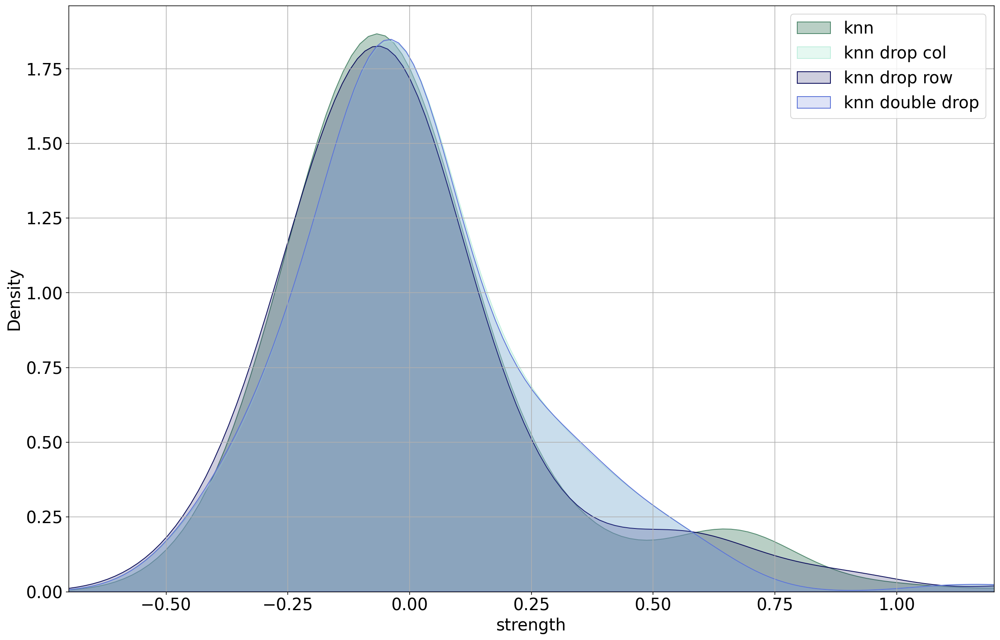

In [23]:
sns.kdeplot(err_knn, alpha = 0.4, label = 'knn', fill = True, color = np.random.uniform(0,1,3) )
sns.kdeplot(err_knn2, alpha = 0.4, label = 'knn drop col', fill = True, color = np.random.uniform(0,1,3))
sns.kdeplot(err_knn3, alpha = 0.2, label = 'knn drop row', fill = True, color = np.random.uniform(0,1,3) )
sns.kdeplot(err_knn4, alpha = 0.2, label = 'knn double drop', fill = True, color = np.random.uniform(0,1,3))
plt.xlim(-0.7, 1.2)
plt.grid()
plt.legend()

Highest score achieved is roughly 0.81 (r^2) with a distribution of MAE normalized to y
<br>
Let's try to add some new columns with non linear combinations of features

In [24]:
train_set_new_feat = train_set_drop
train_set_new_feat['agg'] = train_set['fineagg'] * train_set['coarseagg']
test_set_new_feat = test_set_drop
test_set_new_feat['agg'] = test_set['fineagg'] * test_set['coarseagg']

train_set_new_feat = train_set_new_feat.reindex(columns = ['cement', 'water', 'superplastic', 'age', 'agg', 'strength'])
test_set_new_feat = test_set_new_feat.reindex(columns = ['cement', 'water', 'superplastic', 'age', 'agg', 'strength'])

train_set_new_feat.corr().sort_values('strength', ascending = False).strength

strength        1.000000
cement          0.509415
superplastic    0.370794
age             0.327172
agg            -0.265537
water          -0.310189
Name: strength, dtype: float64

Better correlations

In [25]:
X_train = train_set_new_feat.iloc[:,:-1]
y_train = train_set_new_feat.iloc[:,-1]
X_test = test_set_new_feat.iloc[:,:-1]
y_test = test_set_new_feat.iloc[:,-1]

KNN score = 0.7702997176209663
KNN best parameters = {'metric': 'manhattan', 'n_neighbors': 8, 'weights': 'distance'}


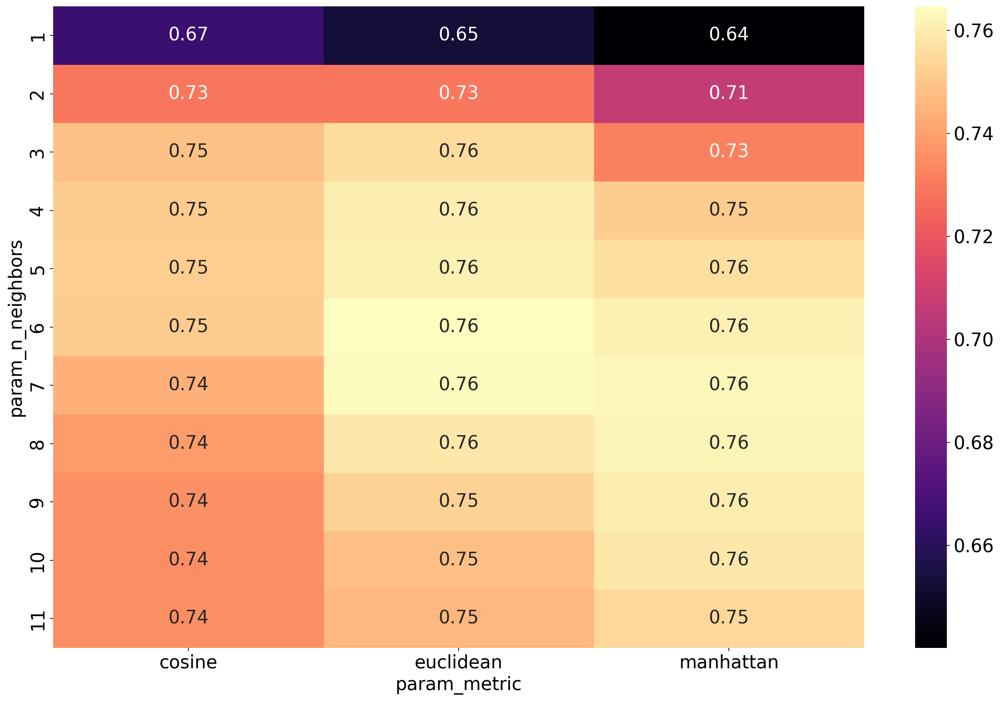

In [26]:
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

parameters = {'n_neighbors':[i for i in range(1,12)],
              'weights':['uniform', 'distance'],
              'metric':['euclidean','manhattan', 'cosine']}
knn = KNeighborsRegressor()
grid = GridSearchCV(knn, parameters) 
grid.fit(X_train_scaled, y_train)
print('KNN score =', grid.best_estimator_.score(X_test_scaled, y_test))
print('KNN best parameters =', grid.best_params_)

hmknn = pd.pivot_table(pd.DataFrame(grid.cv_results_),
									values='mean_test_score',
									index='param_n_neighbors',
									columns='param_metric')

sns.heatmap(hmknn, cmap = 'magma', annot = True)
err_knn5 =  (grid.predict(X_test_scaled) - y_test)/y_test

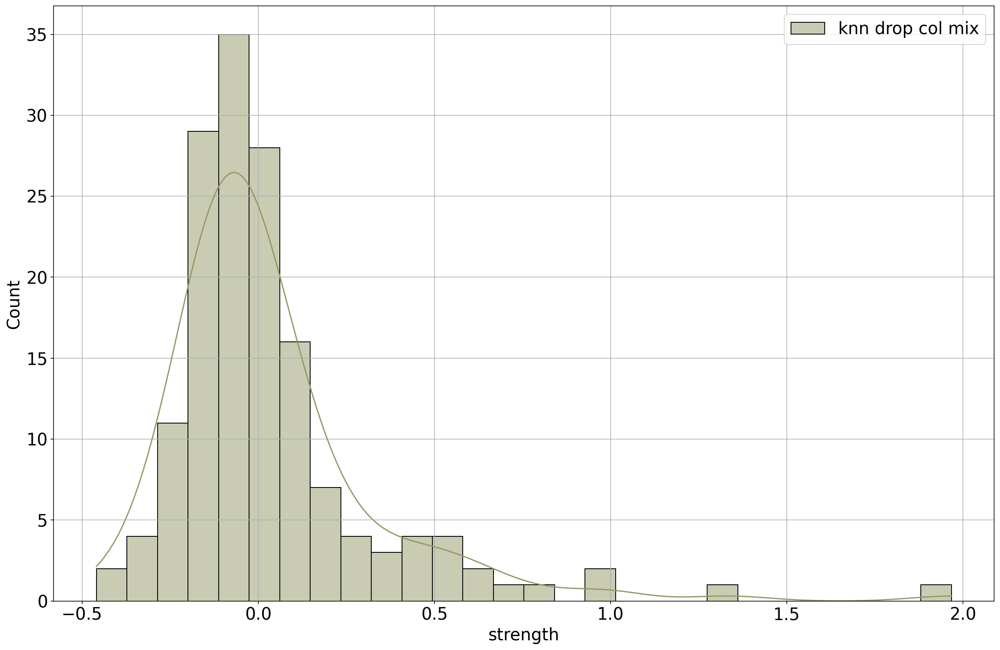

In [27]:
sns.histplot(err_knn5, label = 'knn drop col mix', kde = True, color = np.random.uniform(0, 1, 3) )
plt.xlabel('strength')
plt.grid()
plt.legend()

Slightly improved model

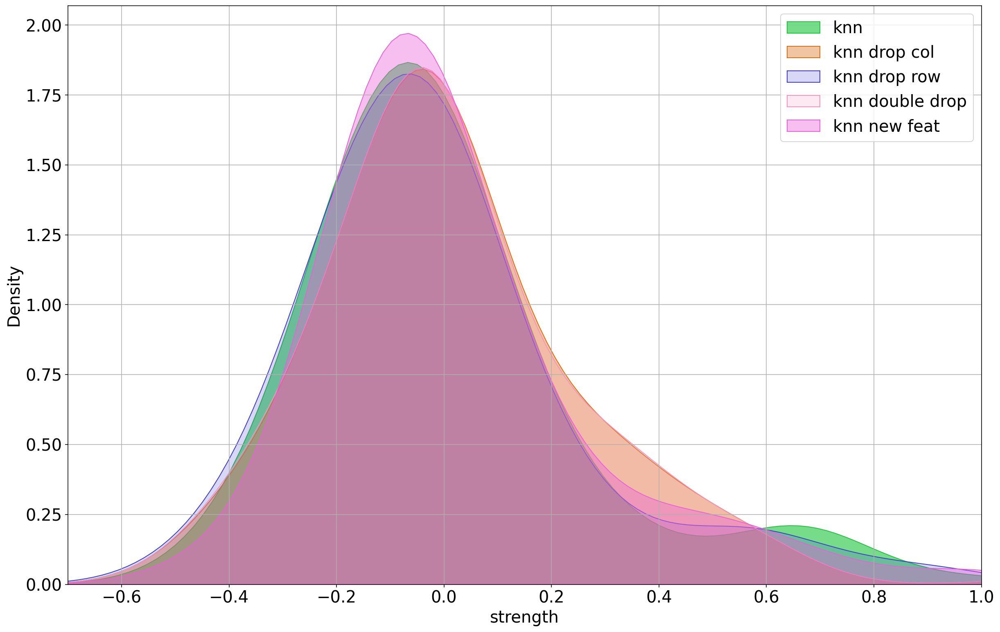

In [28]:
sns.kdeplot(err_knn, alpha = 0.6, label = 'knn', fill = True, color = np.random.uniform(0,1,3) )
sns.kdeplot(err_knn2, alpha = 0.4, label = 'knn drop col', fill = True, color = np.random.uniform(0,1,3))
sns.kdeplot(err_knn3, alpha = 0.2, label = 'knn drop row', fill = True, color = np.random.uniform(0,1,3) )
sns.kdeplot(err_knn4, alpha = 0.2, label = 'knn double drop', fill = True, color = np.random.uniform(0,1,3))
sns.kdeplot(err_knn5, alpha = 0.4, label = 'knn new feat', fill = True, color = np.random.uniform(0,1,3))
plt.xlim(-0.7, 1)
plt.grid()
plt.legend()

Add more features

In [29]:
train_set_new_feat['bho'] = train_set['water'] * train_set_new_feat['agg']
train_set_new_feat['rest'] = 5*train_set['superplastic'] + train_set_new_feat['age']
test_set_new_feat['bho'] = test_set['water'] * test_set_new_feat['agg']
test_set_new_feat['rest'] = 5*test_set['superplastic'] + test_set_new_feat['age']

train_set_new_feat = train_set_new_feat.reindex(columns = ['cement', 'water', 'superplastic', 'age', 'agg', 'bho', 'rest', 'strength'])
test_set_new_feat = test_set_new_feat.reindex(columns = ['cement', 'water', 'superplastic', 'age', 'agg', 'bho', 'rest', 'strength'])

corr = train_set_new_feat.corr().sort_values('strength', ascending = False).strength
corr

strength        1.000000
cement          0.509415
rest            0.494659
superplastic    0.370794
age             0.327172
agg            -0.265537
water          -0.310189
bho            -0.573283
Name: strength, dtype: float64

Let's see new features distributions

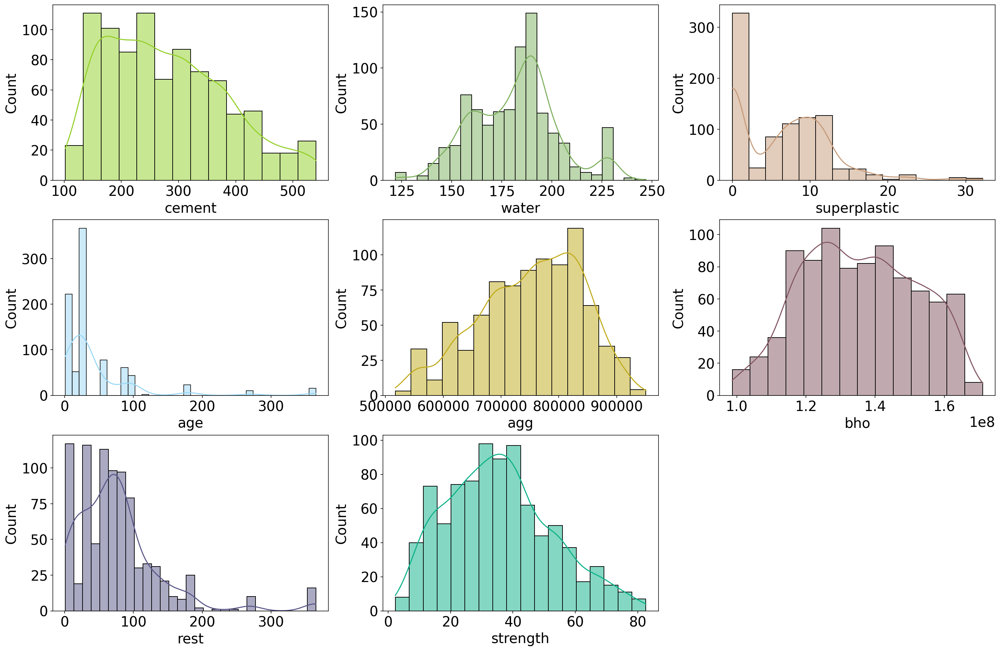

In [30]:
fig,axes = plt.subplots(3, 3, constrained_layout = True)
for i,ax in enumerate(axes.ravel()):
    if i == 8:
        fig.delaxes(ax)
        continue
    rgb = np.random.rand(3,)
    graph = sns.histplot( x = train_set_new_feat.iloc[:,i], kde = True, color = rgb, ax = ax)

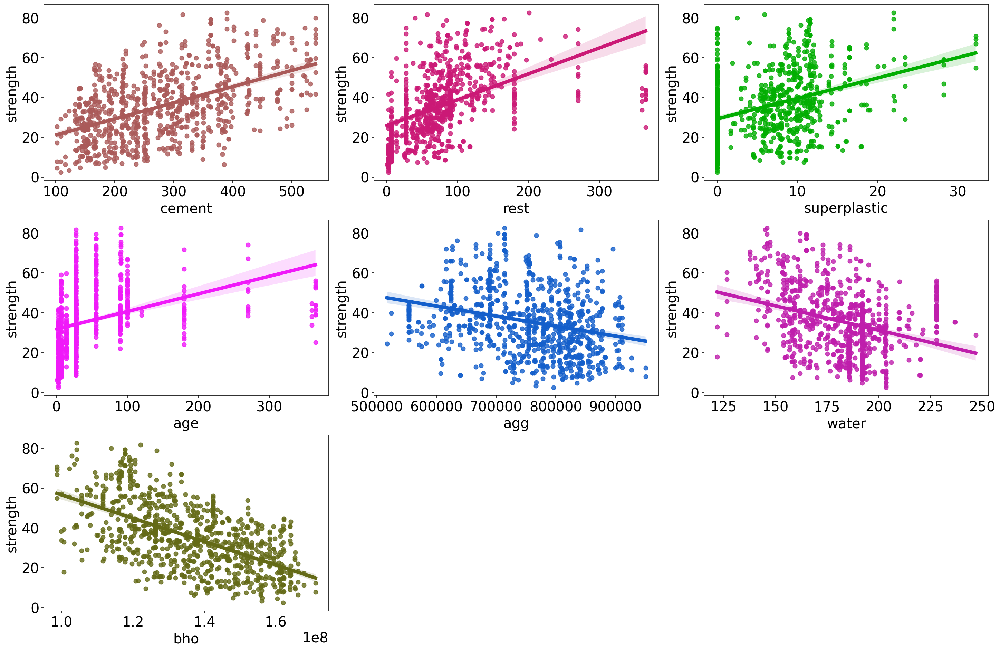

In [31]:
fig, axes = plt.subplots(3,3, constrained_layout = True)
for i, ax in enumerate(axes.ravel()):
    if i == 7 or i == 8:
        fig.delaxes(ax)
        continue
    sns.regplot(x = train_set_new_feat[corr.index[i+1]], y = train_set_new_feat[corr.index[0]], color = np.random.rand(3,), line_kws={'linewidth':5}, ax = ax)

In [32]:
X_train = train_set_new_feat.iloc[:,:-1]
y_train = train_set_new_feat.iloc[:,-1]
X_test = test_set_new_feat.iloc[:,:-1]
y_test = test_set_new_feat.iloc[:,-1]

KNN score = 0.8270653129715542
KNN best parameters = {'metric': 'manhattan', 'n_neighbors': 10, 'weights': 'distance'}


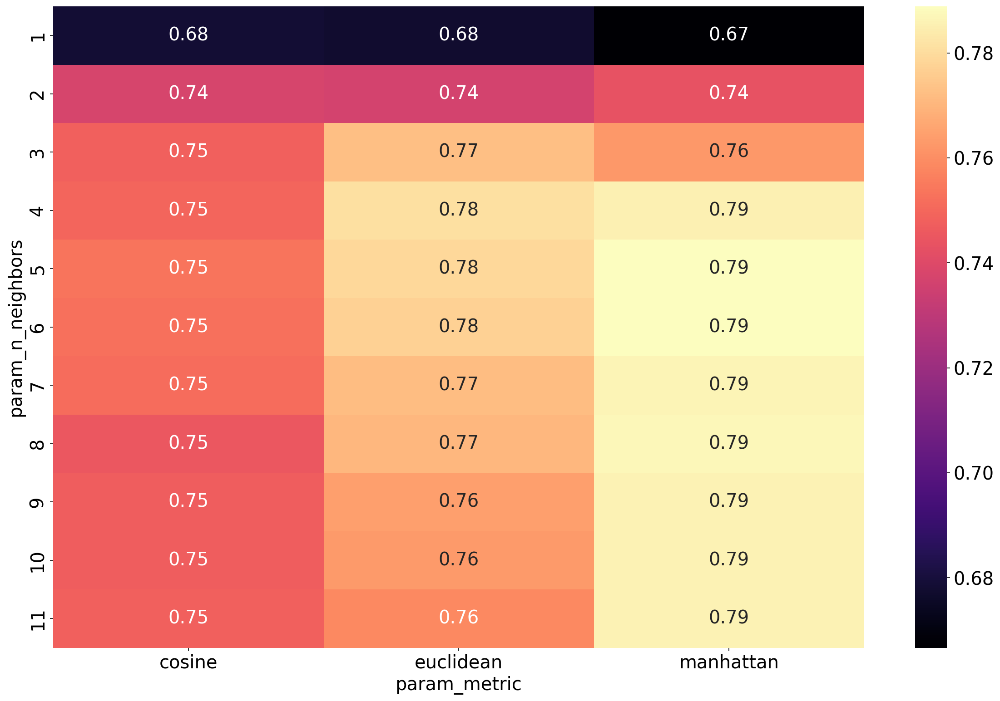

In [33]:
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

parameters = {'n_neighbors':[i for i in range(1,12)],
              'weights':['uniform', 'distance'],
              'metric':['euclidean','manhattan', 'cosine']}
knn = KNeighborsRegressor()
grid = GridSearchCV(knn, parameters) 
grid.fit(X_train_scaled, y_train)
print('KNN score =', grid.best_estimator_.score(X_test_scaled, y_test))
print('KNN best parameters =', grid.best_params_)

hmknn = pd.pivot_table(pd.DataFrame(grid.cv_results_),
									values='mean_test_score',
									index='param_n_neighbors',
									columns='param_metric')

sns.heatmap(hmknn, cmap = 'magma', annot = True)
err_knn6 =  (grid.predict(X_test_scaled) - y_test)/y_test

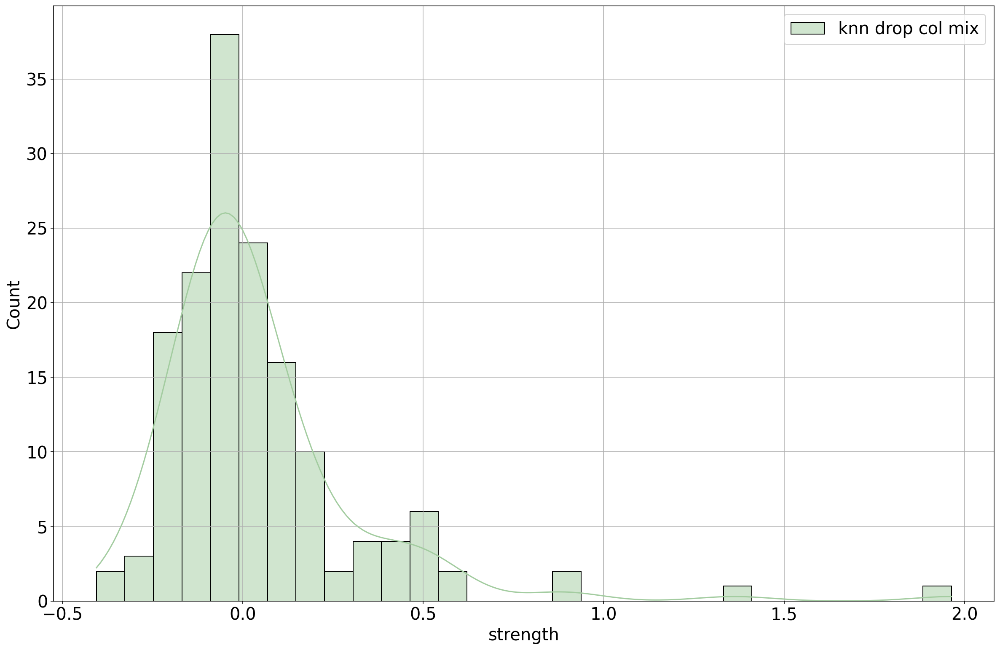

In [34]:
sns.histplot(err_knn6, label = 'knn drop col mix', kde = True, color = np.random.uniform(0, 1, 3) )
plt.xlabel('strength')
plt.grid()
plt.legend()

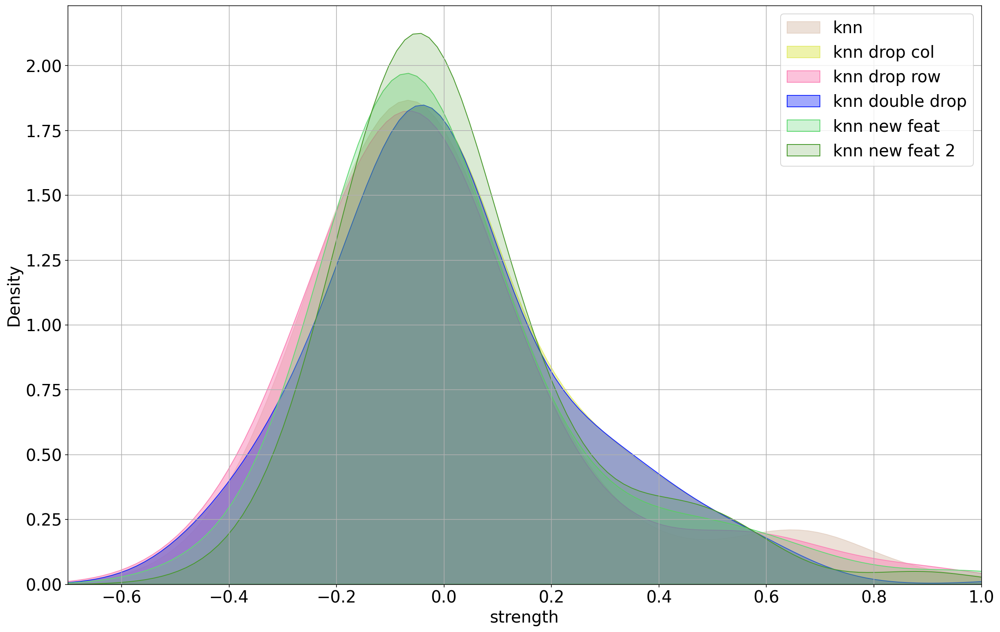

In [35]:
sns.kdeplot(err_knn, alpha = 0.7, label = 'knn', fill = True, color = np.random.uniform(0,1,3) )
sns.kdeplot(err_knn2, alpha = 0.6, label = 'knn drop col', fill = True, color = np.random.uniform(0,1,3))
sns.kdeplot(err_knn3, alpha = 0.5, label = 'knn drop row', fill = True, color = np.random.uniform(0,1,3) )
sns.kdeplot(err_knn4, alpha = 0.4, label = 'knn double drop', fill = True, color = np.random.uniform(0,1,3))
sns.kdeplot(err_knn5, alpha = 0.3, label = 'knn new feat', fill = True, color = np.random.uniform(0,1,3))
sns.kdeplot(err_knn6, alpha = 0.2, label = 'knn new feat 2', fill = True, color = np.random.uniform(0,1,3))
plt.xlim(-0.7, 1)
plt.grid()
plt.legend()

The model trained on the new dataset performs a little bit better
<br>
Another way to visualize the predictions is as it follows

<AxesSubplot:ylabel='strength'>

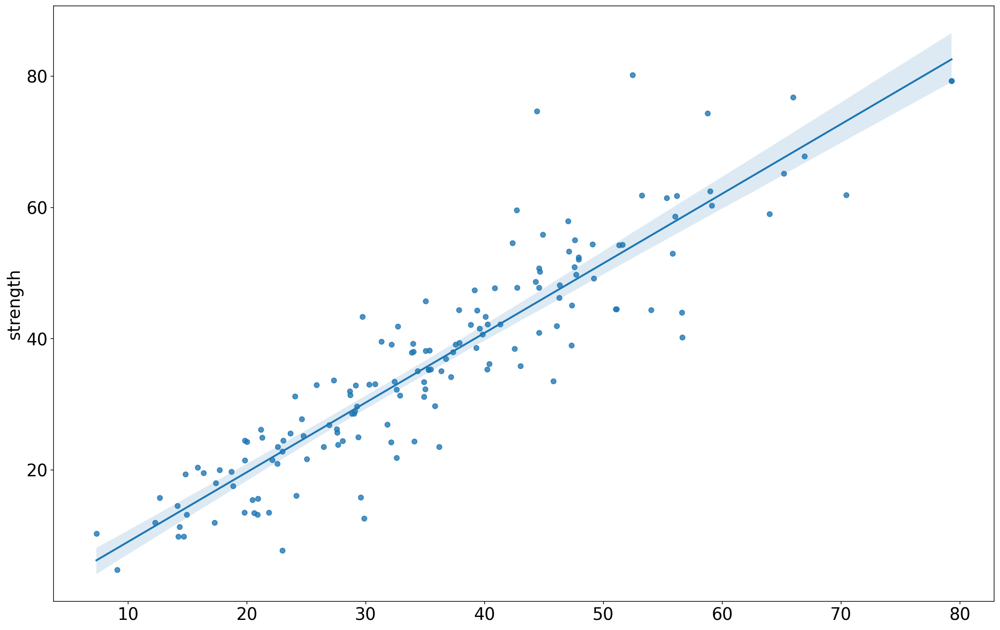

In [36]:
sns.regplot(x = grid.predict(X_test_scaled), y = y_test)

Kinda straigth, that's not bad at all
<br>
But still crappy compared to a SVM prediction as you can see down here

In [37]:
from sklearn.svm import SVR
params = {'kernel':['linear', 'rbf', 'poly'],
          'C':[0.01, 0.1, 1, 10 , 100],
          'epsilon':[0.0001, 0.001, 0.01, 0.1, 1]}
svr = SVR()

grid = GridSearchCV(svr, params)
grid.fit(X_train_scaled, y_train)
err_svr = (grid.predict(X_test_scaled) - y_test)/y_test

print(grid.score(X_test_scaled, y_test))
print(grid.best_params_)

0.8427889443213731
{'C': 100, 'epsilon': 1, 'kernel': 'rbf'}


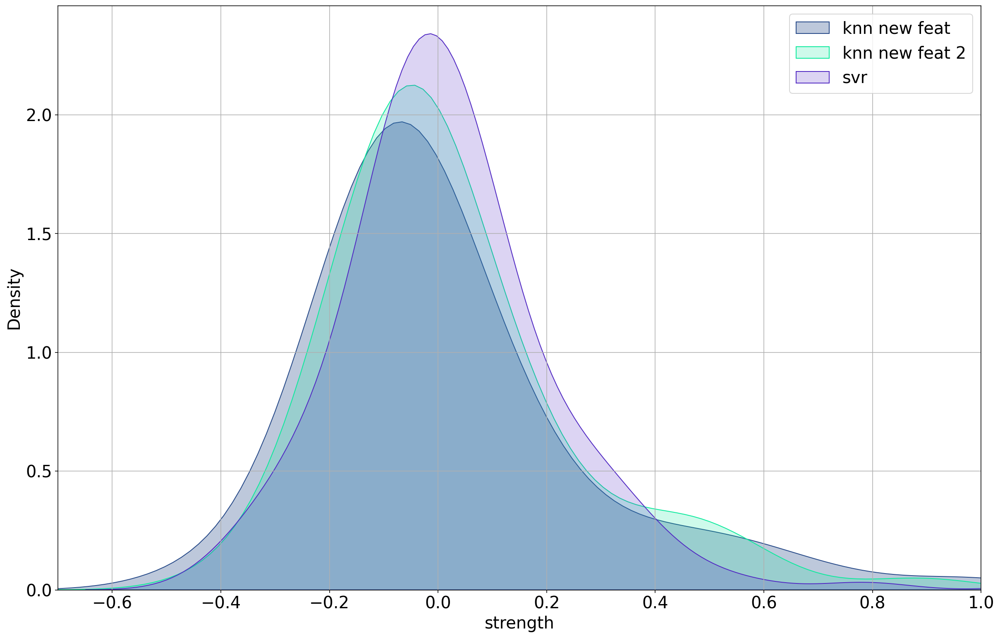

In [38]:
sns.kdeplot(err_knn5, alpha = 0.3, label = 'knn new feat', fill = True, color = np.random.uniform(0,1,3))
sns.kdeplot(err_knn6, alpha = 0.2, label = 'knn new feat 2', fill = True, color = np.random.uniform(0,1,3))
sns.kdeplot(err_svr, alpha = 0.2, label = 'svr', fill = True, color = np.random.uniform(0,1,3))
plt.xlim(-0.7, 1)
plt.grid()
plt.legend()

Conclusion: The purpose was not to find the best of the models but to increase the performance of a model.
<br>
We got a significantly better model compared to the baseline, so mission completed